<a href="https://colab.research.google.com/github/mjgpinheiro/Physics_models/blob/main/spokes_HT.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

Notebook: Simulação inventiva de Rotating Spokes 🚀
Simulação concluída: 501 frames em 50.0 μs
Velocidade de rotação: 1.5 km/s
Número de rotações aproximado: 0.2


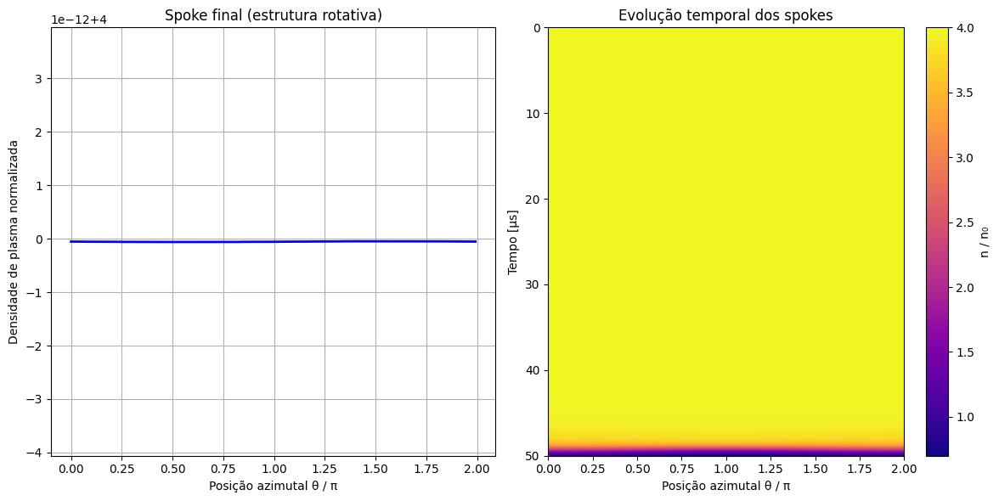

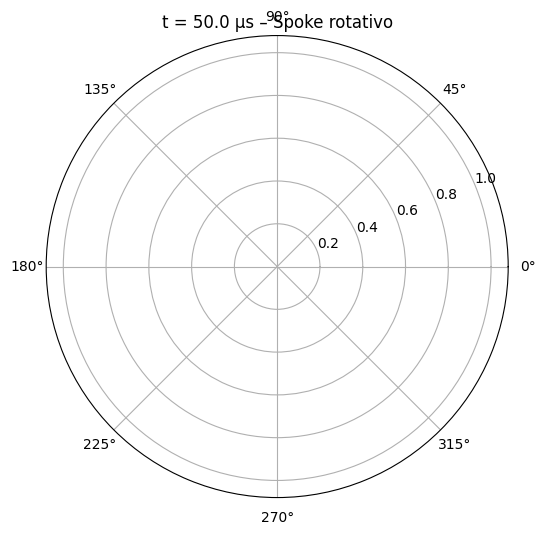

In [1]:
# Notebook Inventivo: Rotating Spokes em Hall Thrusters – Modelo 1D Azimutal Predator-Prey com Rotação
# Inspirado em mecanismos de ionização + gradient-drift simplificado
# Roda em segundos, visualiza spokes rotativos!
import matplotlib as mpl
 mpl.rcParams['animation.embed_limit'] = 50  # Aumenta para 50 MB (ou mais se quiseres)
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation
from IPython.display import HTML
%matplotlib inline

print("Notebook: Simulação inventiva de Rotating Spokes 🚀")

# =============================================================================
# Parâmetros físicos (típicos de Hall thruster 1-5 kW)
# =============================================================================
N_theta = 256                  # Pontos azimutais (resolução do anel)
L_theta = 2 * np.pi            # Comprimento azimutal completo
dtheta = L_theta / N_theta
theta = np.linspace(0, L_theta, N_theta, endpoint=False)

# Taxas [s⁻¹]
nu_iz_base = 1e6               # Taxa de ionização base (ajusta amplitude)
nu_loss = 5e5                  # Perda para paredes (estabiliza)
S_neutral = 2e6                # Fonte constante de neutros

# Velocidade de rotação do spoke (típica: 1-3 km/s << VE×B ~ 10⁶ m/s)
v_spoke = 1500                 # m/s (positivo = sentido E×B)
v_rotate = v_spoke / (0.05)    # Ajusta para raio médio ~5 cm → taxa angular [rad/s]

# Densidades normalizadas iniciais
n = np.ones(N_theta) * 0.8                       # Plasma quase uniforme
nn = np.ones(N_theta) * 2.0                      # Neutros
# Perturbação inicial pequena para iniciar spoke m=1
n += 0.1 * np.cos(theta)
nn -= 0.05 * np.cos(theta)

# Tempo
dt = 1e-7                              # Passo temporal pequeno para estabilidade
T_max = 5e-5                           # ~50 μs (várias rotações)
n_steps = int(T_max / dt)
save_every = max(1, n_steps // 500)    # Salva frames para animação

# Armazena para animação
frames_n = []
times = []

# =============================================================================
# Loop temporal (esquema explícito simples)
# =============================================================================
for step in range(n_steps + 1):
    t = step * dt

    # Salva frame periodicamente
    if step % save_every == 0:
        frames_n.append(n.copy())
        times.append(t * 1e6)  # em μs

    if step == n_steps:
        break

    # Taxa de ionização local (predator-prey)
    nu_iz = nu_iz_base * nn

    # Evolução
    dn_dt = (nu_iz - nu_loss) * n
    dnn_dt = S_neutral - nu_iz * n

    # Advecção para rotação do spoke (upwind simples no sentido positivo)
    n_roll = np.roll(n, 1)
    dn_dt += -v_rotate * (n - n_roll) / dtheta

    # Atualiza (Euler explícito)
    n += dn_dt * dt
    nn += dnn_dt * dt

    # Condições periódicas já implícitas com roll
    # Evita negativos
    n = np.maximum(n, 0.01)
    nn = np.maximum(nn, 0.1)

# =============================================================================
# Resultados
# =============================================================================
print(f"Simulação concluída: {len(frames_n)} frames em {T_max*1e6:.1f} μs")
print(f"Velocidade de rotação: {v_spoke/1000:.1f} km/s")
print(f"Número de rotações aproximado: {v_spoke * T_max / (0.05 * 2 * np.pi):.1f}")

# Plot final
plt.figure(figsize=(12,6))
plt.subplot(1,2,1)
plt.plot(theta / np.pi, frames_n[-1], 'b-', lw=2)
plt.xlabel('Posição azimutal θ / π')
plt.ylabel('Densidade de plasma normalizada')
plt.title('Spoke final (estrutura rotativa)')
plt.grid(True)

plt.subplot(1,2,2)
plt.imshow(frames_n, extent=[0, 2, times[-1], times[0]], aspect='auto',
           cmap='plasma', origin='lower')
plt.xlabel('Posição azimutal θ / π')
plt.ylabel('Tempo [μs]')
plt.title('Evolução temporal dos spokes')
plt.colorbar(label='n / n₀')
plt.tight_layout()
plt.show()

# =============================================================================
# Animação da rotação do spoke
# =============================================================================
fig, ax = plt.subplots(figsize=(10,6), subplot_kw={'projection': 'polar'})
ax.set_title('Rotating Spoke no canal anelar (vista de cima)')
line, = ax.plot([], [], 'b-', lw=3)
point, = ax.plot([], [], 'wo', markersize=10)

def init():
    line.set_data([], [])
    point.set_data([], [])
    ax.set_ylim(0, frames_n[0].max() * 1.2)
    return line, point

def animate(i):
    line.set_data(theta, frames_n[i])
    max_pos = theta[np.argmax(frames_n[i])]
    point.set_data([max_pos], [frames_n[i].max()])
    ax.set_title(f't = {times[i]:.1f} μs – Spoke rotativo')
    return line, point

anim = FuncAnimation(fig, animate, init_func=init, frames=len(frames_n),
                     interval=50, blit=False)

HTML(anim.to_jshtml())

# =============================================================================
# Configuração para evitar o aviso de tamanho
# =============================================================================
import matplotlib as mpl
mpl.rcParams['animation.embed_limit'] = 100  # 100 MB – mais que suficiente

# =============================================================================
# Animação da rotação do spoke (vista polar)
# =============================================================================
fig, ax = plt.subplots(figsize=(10,6), subplot_kw={'projection': 'polar'})
ax.set_title('Rotating Spoke no canal anelar (vista de cima)')
ax.set_theta_direction(-1)  # Sentido horário ou anti-horário (ajusta para E×B real)
ax.set_theta_zero_location('N')  # 0° no topo

line, = ax.plot([], [], 'b-', lw=4, label='Densidade de plasma')
fill = ax.fill([], [], 'cyan', alpha=0.4)
point, = ax.plot([], [], 'wo', markersize=12, markeredgecolor='black', label='Pico do spoke')

ax.legend(loc='upper right')

def init():
    line.set_data([], [])
    fill.remove()  # Necessário para fill
    fill = ax.fill([], [], 'cyan', alpha=0.4)
    point.set_data([], [])
    ax.set_ylim(0, frames_n[0].max() * 1.3)
    return line, point

def animate(i):
    global fill
    line.set_data(theta, frames_n[i])
    if 'fill' in globals():
        fill.remove()
    fill = ax.fill(theta, frames_n[i], 'cyan', alpha=0.4)

    max_pos = theta[np.argmax(frames_n[i])]
    point.set_data([max_pos], [frames_n[i].max()])

    ax.set_title(f't = {times[i]:.1f} μs – Spoke rotativo ({v_spoke/1000:.1f} km/s)')
    return line, point, fill

anim = FuncAnimation(fig, animate, init_func=init, frames=len(frames_n),
                     interval=60, blit=False, repeat=True)

# Para ver no Colab/Jupyter:
HTML(anim.to_jshtml())